In [1]:
! export CUDA_VISIBLE_DEVICES=1

In [2]:
from collections import OrderedDict
from utils.tokenizer import SimpleTokenizer
import models.ULIP_models as models
from main import get_args_parser
import argparse
from utils import utils
import numpy as np

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [3]:
import torch
import torchvision.transforms as transforms
import torch.nn.functional as F
import os
import random

In [4]:
from ULIP_ShapeNet_Dataset.ULIP_ShapeNet import ULIP_ShapeNet

# GPU Session

In [8]:
os.environ["CUDA_VISIBLE_DEVICES"] = "1"

In [9]:
print(os.environ["CUDA_VISIBLE_DEVICES"])

1


In [10]:
print(torch.cuda.current_device())        # 当前设备的索引
print(torch.cuda.device_count())          # 可用的设备数量
print("CUDA device name:", torch.cuda.get_device_name(0))    # 设备 0 的名称

0
3
CUDA device name: NVIDIA A100-PCIE-40GB


# Current support class

In [11]:
# Define class names and descriptions
shapenet_classes = ['table', 'car', 'bottle', 
                    'chair', 'airplane', 'laptop', 'knife', 'train', 'lamp', 
                    'bin', 'watercraft', 
                    'rocket', 'bag', 
                    'bed', 'display', 'piano', 'telephone', 
                    'bus', 'bowl', 
                    'keyboard', 'guitar', 'bicycle', 'printer', 'cap']

img_descriptions = []
pc_descriptions = []

for i, sn_class in enumerate(shapenet_classes):
    img_descriptions.append(f'This is an image of a 3D rendering {sn_class}')
    # img_descriptions.append(f'This is an image of a {sn_class}')
    
    pc_descriptions.append(f'This is a 3D point cloud of a {sn_class}')

print(img_descriptions)
print(pc_descriptions)

['This is an image of a 3D rendering table', 'This is an image of a 3D rendering car', 'This is an image of a 3D rendering bottle', 'This is an image of a 3D rendering chair', 'This is an image of a 3D rendering airplane', 'This is an image of a 3D rendering laptop', 'This is an image of a 3D rendering knife', 'This is an image of a 3D rendering train', 'This is an image of a 3D rendering lamp', 'This is an image of a 3D rendering bin', 'This is an image of a 3D rendering watercraft', 'This is an image of a 3D rendering rocket', 'This is an image of a 3D rendering bag', 'This is an image of a 3D rendering bed', 'This is an image of a 3D rendering display', 'This is an image of a 3D rendering piano', 'This is an image of a 3D rendering telephone', 'This is an image of a 3D rendering bus', 'This is an image of a 3D rendering bowl', 'This is an image of a 3D rendering keyboard', 'This is an image of a 3D rendering guitar', 'This is an image of a 3D rendering bicycle', 'This is an image of

# Load the ULIP pretrained 3D encoder and OpenCLIP

In [17]:
def create_fake_args():
    parser = argparse.ArgumentParser('ULIP training and evaluation', parents=[get_args_parser()])
    fake_args = parser.parse_args([])  # 使用空列表初始化命名空间
    # 手动设置每个参数的值
    fake_args.output_dir = './outputs'
    # fake_args.npoints = 8192
    fake_args.npoints = 10000
    fake_args.model = 'ULIP2_PointBERT_Colored'
    fake_args.gpu = 1
    # fake_args.test_ckpt_addr = './pretrained_models/pointbert_ULIP-2.pt'
    fake_args.test_ckpt_addr = './pretrained_models/ULIP-2-PointBERT-10k-colored-pc-pretrained.pt'
    fake_args.evaluate_3d_ulip2 = True
    fake_args.if_need_clip = True

    return fake_args

args = create_fake_args()

In [13]:
ckpt = torch.load(args.test_ckpt_addr, map_location='cpu')

# 遍历状态字典并移除 'module.' 前缀
state_dict = OrderedDict()
for k, v in ckpt['state_dict'].items():
    state_dict[k.replace('module.', '')] = v


In [42]:
print("=> creating model: {}".format(args.model))

# create the model
model = getattr(models, args.model)(args=args)
model.cuda(args.gpu)

print("")

=> creating model: ULIP2_PointBERT_Colored
Get openclip model:
Finished loading the openclip model.
PointTransformer_Colored model size:
32.50M



In [43]:
# load the parameters
model.load_state_dict(state_dict, strict=False)
# model.load_state_dict(state_dict, strict=True)

print("=> loaded pretrained checkpoint '{}'".format(args.test_ckpt_addr))

=> loaded pretrained checkpoint './pretrained_models/ULIP-2-PointBERT-10k-colored-pc-pretrained.pt'


In [44]:
model.eval()

print("")

# Load the ULIP ShapeNet dataset

## Plane data

In [21]:
plane_dataset = ULIP_ShapeNet(keyword="plane")
print(len(plane_dataset))

2860


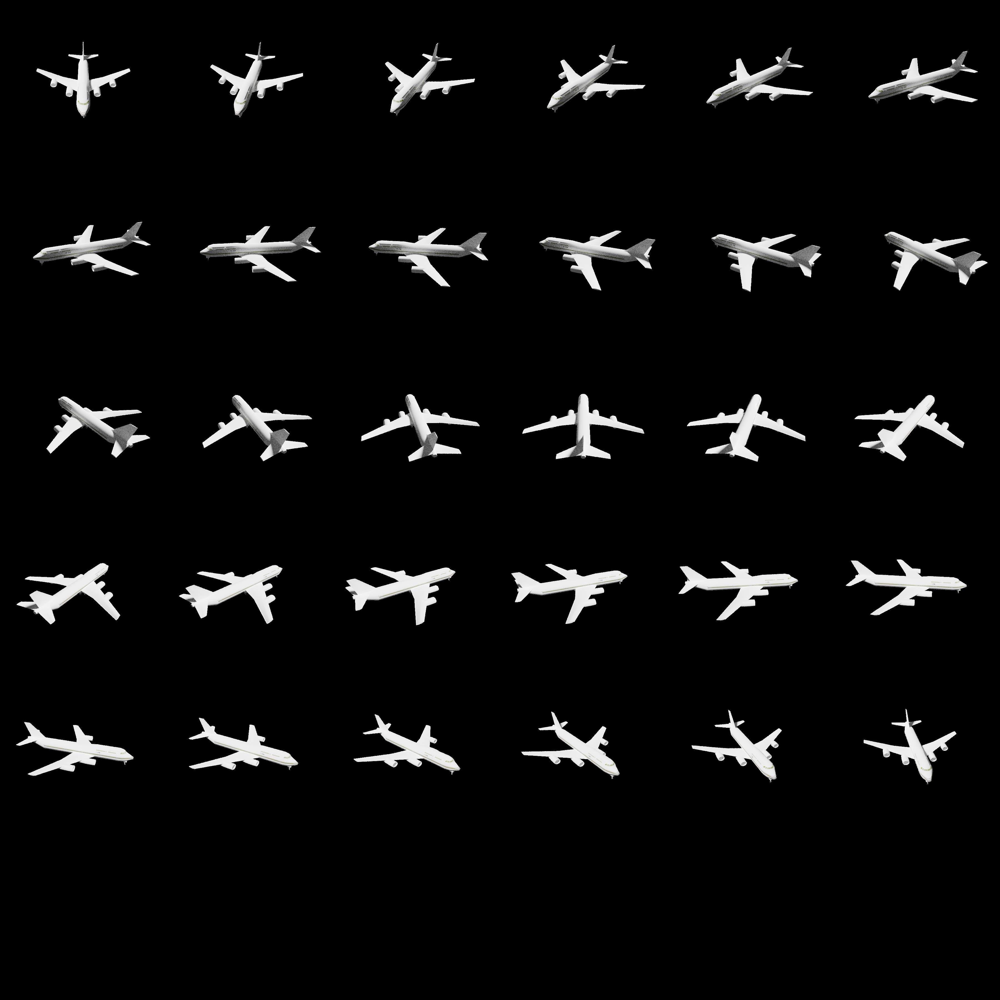

In [22]:
plane_1, plane_RGB_imgs_show_1 = plane_dataset.process_index(show_images=True)

In [23]:
plane_1_index_A, plane_1_index_B = plane_dataset.choose_random_angles(plane_1, 60)

plane_1_angle_A = plane_1[f"angle_{plane_1_index_A}"]["angle"]
plane_1_image_A = plane_1[f"angle_{plane_1_index_A}"]["image"]
plane_1_angle_B = plane_1[f"angle_{plane_1_index_B}"]["angle"]
plane_1_image_B = plane_1[f"angle_{plane_1_index_B}"]["image"]
plane_1_captions_B = plane_1[f"angle_{plane_1_index_B}"]["captions"]

print(plane_1_angle_A)
print(plane_1_angle_B)
print(abs(plane_1_angle_A - plane_1_angle_B))

276
288
12


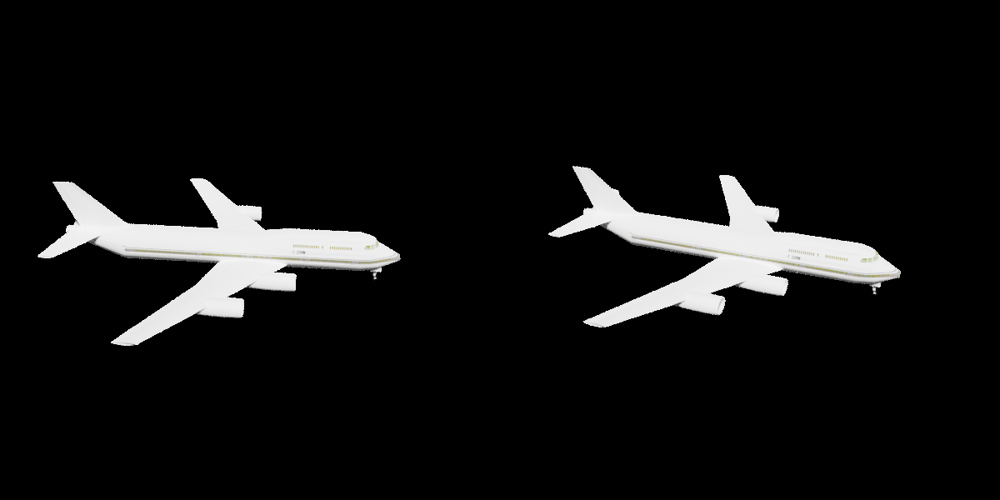

In [24]:
plane_dataset.merge_images_horizontally(plane_1_image_A, plane_1_image_B)

In [25]:
plane_1_captions_B

['a drawing of a jetliner on a grey background',
 'an artistic rendering of a large jet airplane on a grey background',
 'a plane is pictured flying in a gray area',
 'a 3-d computer generated image of a large passenger jet',
 'a plane in 3d for a computer program',
 'a white plane flying in the sky on a grey background',
 'a 3d model of a passenger jet is shown',
 'a plane with four engines in a gray sky',
 'a white airplane in the sky against a gray background',
 'there is a large white airplane that is flying through the air']

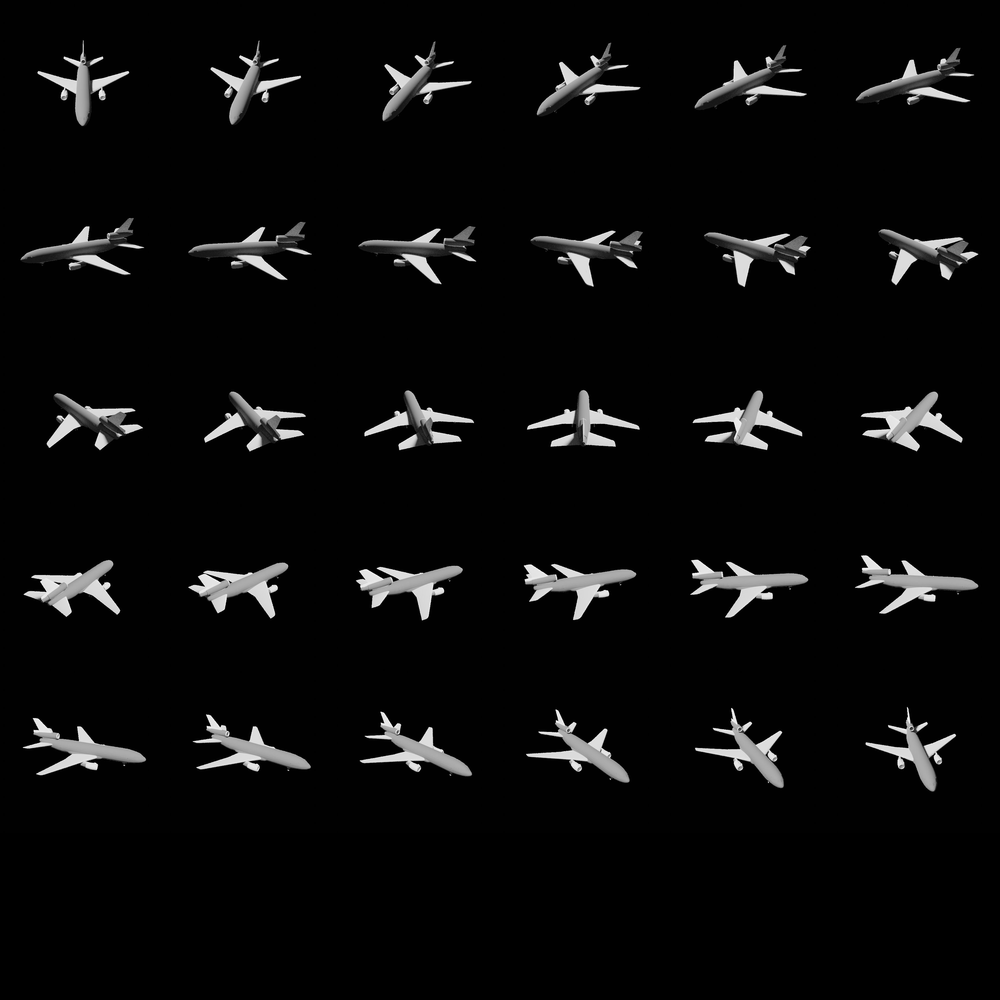

In [26]:
plane_2, plane_RGB_imgs_show_2 = plane_dataset.process_index(show_images=True)

In [27]:
plane_2_index_A, plane_2_index_B = plane_dataset.choose_random_angles(plane_2, 60)

plane_2_angle_A = plane_2[f"angle_{plane_2_index_A}"]["angle"]
plane_2_image_A = plane_2[f"angle_{plane_2_index_A}"]["image"]
plane_2_angle_B = plane_2[f"angle_{plane_2_index_B}"]["angle"]
plane_2_image_B = plane_2[f"angle_{plane_2_index_B}"]["image"]
plane_2_captions_B = plane_2[f"angle_{plane_2_index_B}"]["captions"]

print(plane_2_angle_A)
print(plane_2_angle_B)
print(abs(plane_2_angle_A - plane_2_angle_B))

0
348
348


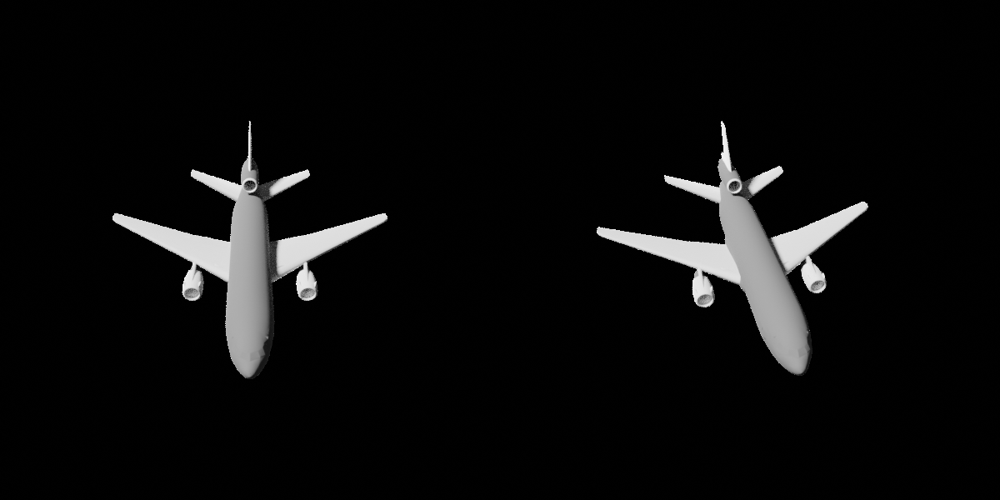

In [28]:
plane_dataset.merge_images_horizontally(plane_2_image_A, plane_2_image_B)

In [29]:
plane_2_captions_B

['a 3d view of an airplane on a gray background',
 'there is a 3d rendering of a plane flying',
 'a plane flying in the air in gray sky',
 'a gray and white model of an airplane',
 'a plane is flying in mid air',
 'a large jet plane flying on a gray day',
 'this is a 3d animation of an airplane flying',
 'a picture of a plane floating in the sky',
 'a very low image of an airplane flying in the sky',
 'a plane is in the sky with no people']

## Chair data

In [30]:
chair_dataset = ULIP_ShapeNet(keyword="chair")
print(len(chair_dataset))

4504


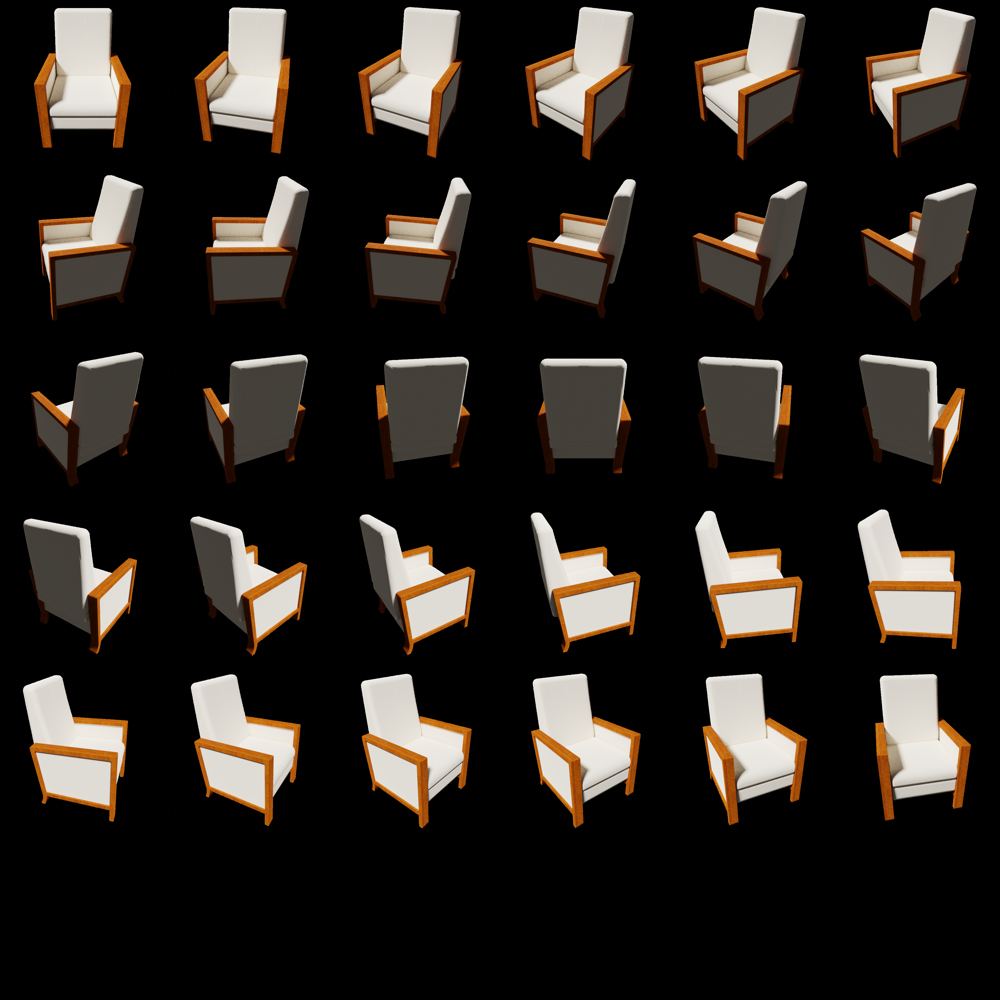

In [31]:
chair_1, chair_RGB_imgs_show_1 = chair_dataset.process_index(show_images=True)

In [32]:
chair_1_index_A, chair_1_index_B = chair_dataset.choose_random_angles(chair_1, 60)

chair_1_angle_A = chair_1[f"angle_{chair_1_index_A}"]["angle"]
chair_1_image_A = chair_1[f"angle_{chair_1_index_A}"]["image"]
chair_1_angle_B = chair_1[f"angle_{chair_1_index_B}"]["angle"]
chair_1_image_B = chair_1[f"angle_{chair_1_index_B}"]["image"]
chair_1_captions_B = chair_1[f"angle_{chair_1_index_B}"]["captions"]

print(chair_1_angle_A)
print(chair_1_angle_B)
print(abs(chair_1_angle_A - chair_1_angle_B))

276
300
24


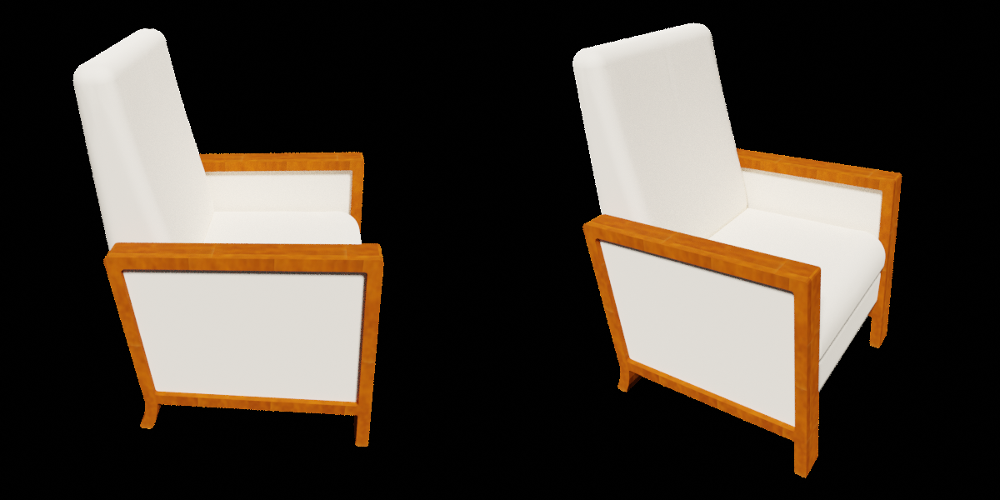

In [33]:
chair_dataset.merge_images_horizontally(chair_1_image_A, chair_1_image_B)

In [34]:
chair_1_captions_B

['a computer generated image of a chair',
 'a rendered chair in a 3d computer simulation',
 'a chair with some wooden legs on a white background',
 'an image of a chair that has one arm off to the side',
 'a chair with wood arms in a grey background',
 'a chair in an isometric pose, ready for action',
 'a modern and comfortable chair designed in an illustration',
 'an empty white chair is shown in the computer',
 'a chair is sitting in the back of a studio',
 'a chair sitting alone in a dark room']

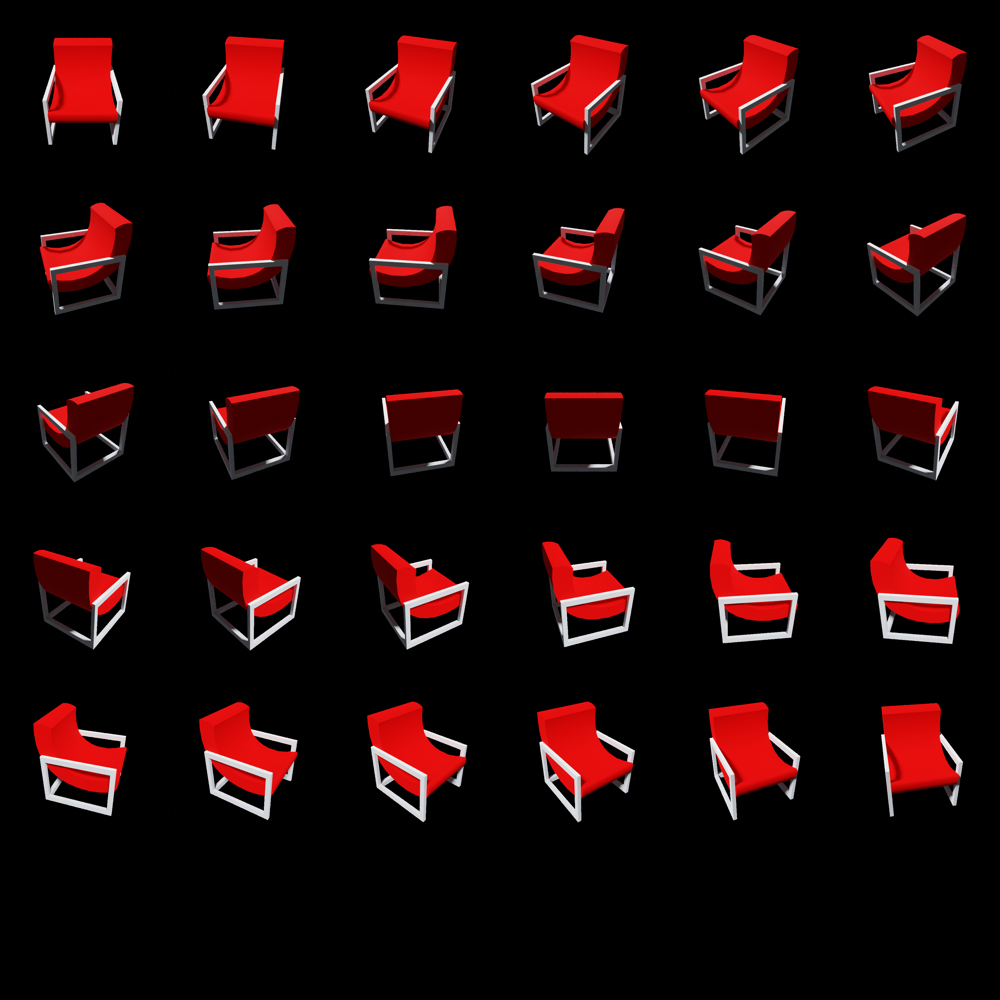

In [35]:
chair_2, chair_RGB_imgs_show_2 = chair_dataset.process_index(show_images=True)

In [36]:
chair_2_index_A, chair_2_index_B = chair_dataset.choose_random_angles(chair_2, 60)

chair_2_angle_A = chair_2[f"angle_{chair_2_index_A}"]["angle"]
chair_2_image_A = chair_2[f"angle_{chair_2_index_A}"]["image"]
chair_2_angle_B = chair_2[f"angle_{chair_2_index_B}"]["angle"]
chair_2_image_B = chair_2[f"angle_{chair_2_index_B}"]["image"]
chair_2_captions_B = chair_2[f"angle_{chair_2_index_B}"]["captions"]

print(chair_2_angle_A)
print(chair_2_angle_B)
print(abs(chair_2_angle_A - chair_2_angle_B))

60
48
12


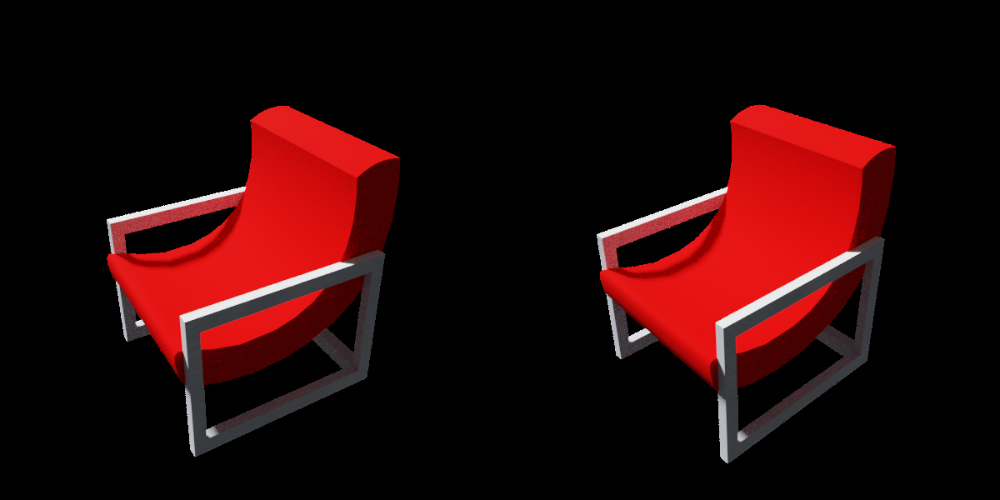

In [37]:
chair_dataset.merge_images_horizontally(chair_2_image_A, chair_2_image_B)

In [38]:
chair_2_captions_B

['a red and white chair without a leg',
 'a computer rendering of a small chair',
 'a chair with a red seat and white arm rest',
 'a red and white chair on a gray surface',
 'an armchair in front of a grey wall',
 'a red and white chair on a plain gray background',
 'a chair with orange color',
 'a red chair in a dark room against a gray background',
 'a photo of a chair with a very nice design',
 'an image of a chair with arms on a desk']

# Inference

In [39]:
def encode_text(text):
    with torch.no_grad():

        print("")

        text_token = model.tokenizer(text).cuda(args.gpu, non_blocking=True)

        print("text_token.shape: ")
        print(text_token.shape)

        if len(text_token.shape) < 2:
            text_token = text_token[None, ...]

        print("text_token.shape after checking: ")
        print(text_token.shape)

        text_embeddings = model.encode_text(text_token).float()
        text_embeddings = text_embeddings / text_embeddings.norm(dim=-1, keepdim=True)
        
        print("text_embeddings.shape")
        print(text_embeddings.shape)
        print("text_embeddings.norm(dim=-1)")
        print(text_embeddings.norm(dim=-1))

        print("")

        return text_embeddings

In [40]:
def encode_image(image):
    with torch.no_grad():

        print("")

        image_tensor = model.preprocess(image)

        # 检查转换后的 tensor 的形状和类型
        print("image_tensor.shape after preprocess")
        print(image_tensor.shape)

        img_embedding = model.encode_image(
                                image_tensor.unsqueeze(0).float().cuda(args.gpu, non_blocking=True)
                                ).float()
        img_embedding = img_embedding / img_embedding.norm(dim=-1, keepdim=True)
        
        print("img_embedding.shape")
        print(img_embedding.shape)
        print("img_embedding.norm(dim=-1)")
        print(img_embedding.norm(dim=-1))

        print("")

        return img_embedding

## Process the class description

In [45]:
img_class_embeddings = encode_text(img_descriptions)
pc_class_embeddings = encode_text(pc_descriptions)


text_token.shape: 
torch.Size([24, 77])
text_token.shape after checking: 
torch.Size([24, 77])
text_embeddings.shape
torch.Size([24, 1280])
text_embeddings.norm(dim=-1)
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000], device='cuda:1')


text_token.shape: 
torch.Size([24, 77])
text_token.shape after checking: 
torch.Size([24, 77])
text_embeddings.shape
torch.Size([24, 1280])
text_embeddings.norm(dim=-1)
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000], device='cuda:1')



## Process the image

In [46]:
plane_1_image_A_embedding = encode_image(plane_1_image_A)
plane_1_image_B_embedding = encode_image(plane_1_image_B)

plane_2_image_A_embedding = encode_image(plane_2_image_A)
plane_2_image_B_embedding = encode_image(plane_2_image_B)


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.0000], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.0000], device='cuda:1')



In [47]:
chair_1_image_A_embedding = encode_image(chair_1_image_A)
chair_1_image_B_embedding = encode_image(chair_1_image_B)

chair_2_image_A_embedding = encode_image(chair_2_image_A)
chair_2_image_B_embedding = encode_image(chair_2_image_B)


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')


image_tensor.shape after preprocess
torch.Size([3, 224, 224])
img_embedding.shape
torch.Size([1, 1280])
img_embedding.norm(dim=-1)
tensor([1.], device='cuda:1')



### Similarity between the image and class

In [51]:
logits_plane_1_img_A = plane_1_image_A_embedding @ img_class_embeddings.t()
prob_plane_1_img_A = F.softmax(logits_plane_1_img_A, dim=-1)

print(logits_plane_1_img_A)
print(prob_plane_1_img_A)

print("")

logits_plane_2_img_A = plane_2_image_A_embedding @ img_class_embeddings.t()
prob_plane_2_img_A = F.softmax(logits_plane_2_img_A, dim=-1)

print(logits_plane_2_img_A)
print(prob_plane_2_img_A)

tensor([[0.2760, 0.2988, 0.2713, 0.2653, 0.4305, 0.2874, 0.3067, 0.3158, 0.2892,
         0.2431, 0.3170, 0.2980, 0.2303, 0.2538, 0.2904, 0.2875, 0.2861, 0.3052,
         0.2421, 0.2610, 0.2827, 0.2573, 0.2692, 0.2685]], device='cuda:1')
tensor([[0.0413, 0.0422, 0.0411, 0.0408, 0.0482, 0.0417, 0.0426, 0.0430, 0.0418,
         0.0399, 0.0430, 0.0422, 0.0394, 0.0404, 0.0419, 0.0418, 0.0417, 0.0425,
         0.0399, 0.0407, 0.0416, 0.0405, 0.0410, 0.0410]], device='cuda:1')

tensor([[0.2953, 0.2828, 0.2598, 0.2556, 0.4106, 0.2672, 0.2774, 0.2929, 0.2920,
         0.2525, 0.3042, 0.2918, 0.2204, 0.2263, 0.2992, 0.2628, 0.2798, 0.2842,
         0.2349, 0.2560, 0.2690, 0.2367, 0.2740, 0.2717]], device='cuda:1')
tensor([[0.0425, 0.0420, 0.0410, 0.0408, 0.0477, 0.0413, 0.0417, 0.0424, 0.0424,
         0.0407, 0.0429, 0.0423, 0.0394, 0.0397, 0.0427, 0.0411, 0.0418, 0.0420,
         0.0400, 0.0409, 0.0414, 0.0401, 0.0416, 0.0415]], device='cuda:1')


In [54]:
predicted_classes_plane_1_img_A = torch.argmax(prob_plane_1_img_A, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_plane_1_img_A]} with {int(predicted_classes_plane_1_img_A)}th class")

predicted_classes_plane_2_img_A = torch.argmax(prob_plane_2_img_A, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_plane_2_img_A]} with {int(predicted_classes_plane_2_img_A)}th class")

Predicted class of the image: airplane with 4th class
Predicted class of the image: airplane with 4th class


In [55]:
logits_chair_1_img_A = chair_1_image_A_embedding @ img_class_embeddings.t()
prob_chair_1_img_A = F.softmax(logits_chair_1_img_A, dim=-1)

print(logits_chair_1_img_A)
print(prob_chair_1_img_A)

print("")

logits_chair_2_img_A = chair_2_image_A_embedding @ img_class_embeddings.t()
prob_chair_2_img_A = F.softmax(logits_chair_2_img_A, dim=-1)

print(logits_chair_2_img_A)
print(prob_chair_2_img_A)

tensor([[0.3458, 0.2799, 0.2570, 0.4402, 0.2614, 0.2847, 0.2394, 0.2769, 0.3266,
         0.2986, 0.2851, 0.2471, 0.2597, 0.3183, 0.3252, 0.3265, 0.2988, 0.2840,
         0.2871, 0.2327, 0.3142, 0.2496, 0.2902, 0.3171]], device='cuda:1')
tensor([[0.0439, 0.0411, 0.0401, 0.0482, 0.0403, 0.0413, 0.0394, 0.0409, 0.0430,
         0.0418, 0.0413, 0.0397, 0.0402, 0.0427, 0.0430, 0.0430, 0.0418, 0.0412,
         0.0414, 0.0392, 0.0425, 0.0398, 0.0415, 0.0426]], device='cuda:1')

tensor([[0.2921, 0.2398, 0.2073, 0.3903, 0.2161, 0.2166, 0.2256, 0.2242, 0.2857,
         0.2511, 0.2537, 0.2082, 0.2308, 0.2665, 0.2585, 0.2654, 0.2444, 0.2299,
         0.2686, 0.2075, 0.2565, 0.2197, 0.2515, 0.2786]], device='cuda:1')
tensor([[0.0434, 0.0412, 0.0399, 0.0479, 0.0403, 0.0403, 0.0407, 0.0406, 0.0432,
         0.0417, 0.0418, 0.0399, 0.0409, 0.0423, 0.0420, 0.0423, 0.0414, 0.0408,
         0.0424, 0.0399, 0.0419, 0.0404, 0.0417, 0.0429]], device='cuda:1')


In [57]:
predicted_classes_chair_1_img_A = torch.argmax(prob_chair_1_img_A, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_chair_1_img_A]} with {int(predicted_classes_chair_1_img_A)}th class")

predicted_classes_chair_2_img_A = torch.argmax(prob_chair_2_img_A, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_chair_2_img_A]} with {int(predicted_classes_chair_2_img_A)}th class")

Predicted class of the image: chair with 3th class
Predicted class of the image: chair with 3th class


### Similarity between the images

In [48]:
sim_plane_1_img_A_B = plane_1_image_A_embedding @ plane_1_image_B_embedding.t()
print(sim_plane_1_img_A_B)

sim_plane_2_img_A_B = plane_2_image_A_embedding @ plane_2_image_B_embedding.t()
print(sim_plane_2_img_A_B)

sim_plane_1_img_A_plane_2_img_A = plane_1_image_A_embedding @ plane_2_image_A_embedding.t()
print(sim_plane_1_img_A_plane_2_img_A)

sim_plane_1_img_B_plane_2_img_B = plane_1_image_B_embedding @ plane_2_image_B_embedding.t()
print(sim_plane_1_img_B_plane_2_img_B)

tensor([[0.9773]], device='cuda:1')
tensor([[0.9754]], device='cuda:1')
tensor([[0.8374]], device='cuda:1')
tensor([[0.8483]], device='cuda:1')


In [49]:
sim_chair_1_img_A_B = chair_1_image_A_embedding @ chair_1_image_B_embedding.t()
print(sim_chair_1_img_A_B)

sim_chair_2_img_A_B = chair_2_image_A_embedding @ chair_2_image_B_embedding.t()
print(sim_chair_2_img_A_B)

sim_chair_1_img_A_chair_2_img_A = chair_1_image_A_embedding @ chair_2_image_A_embedding.t()
print(sim_chair_1_img_A_chair_2_img_A)

sim_chair_1_img_B_chair_2_img_B = chair_1_image_B_embedding @ chair_2_image_B_embedding.t()
print(sim_chair_1_img_B_chair_2_img_B)

tensor([[0.9517]], device='cuda:1')
tensor([[0.9927]], device='cuda:1')
tensor([[0.6886]], device='cuda:1')
tensor([[0.7110]], device='cuda:1')


In [50]:
sim_plane_1_img_A_chair_1_img_A = plane_1_image_A_embedding @ chair_1_image_A_embedding.t()
print(sim_plane_1_img_A_chair_1_img_A)

sim_plane_1_img_A_chair_2_img_A = plane_1_image_A_embedding @ chair_2_image_A_embedding.t()
print(sim_plane_1_img_A_chair_2_img_A)

sim_plane_2_img_A_chair_1_img_A = plane_2_image_A_embedding @ chair_1_image_A_embedding.t()
print(sim_plane_2_img_A_chair_1_img_A)

sim_plane_2_img_A_chair_2_img_A = plane_2_image_A_embedding @ chair_2_image_A_embedding.t()
print(sim_plane_2_img_A_chair_2_img_A)

tensor([[0.5217]], device='cuda:1')
tensor([[0.4952]], device='cuda:1')
tensor([[0.4755]], device='cuda:1')
tensor([[0.4889]], device='cuda:1')


### Similarity between the point cloud and the class descriptions

In [61]:
plane_1_pc_embedding = plane_1['pointcloud_embedding_tensor'].unsqueeze(0).cuda(args.gpu).float()
plane_1_pc_embedding = plane_1_pc_embedding / plane_1_pc_embedding.norm(dim=-1, keepdim=True)

plane_2_pc_embedding = plane_2['pointcloud_embedding_tensor'].unsqueeze(0).cuda(args.gpu).float()
plane_2_pc_embedding = plane_2_pc_embedding / plane_2_pc_embedding.norm(dim=-1, keepdim=True)

chair_1_pc_embedding = chair_1['pointcloud_embedding_tensor'].unsqueeze(0).cuda(args.gpu).float()
chair_1_pc_embedding = chair_1_pc_embedding / chair_1_pc_embedding.norm(dim=-1, keepdim=True)

chair_2_pc_embedding = chair_2['pointcloud_embedding_tensor'].unsqueeze(0).cuda(args.gpu).float()
chair_2_pc_embedding = chair_2_pc_embedding / chair_2_pc_embedding.norm(dim=-1, keepdim=True)

In [62]:
# cosine similarity as logits
logits_pc_plane_1 = plane_1_pc_embedding @ pc_class_embeddings.t()
print(logits_pc_plane_1)

logits_pc_plane_2 = plane_2_pc_embedding @ pc_class_embeddings.t()
print(logits_pc_plane_2)

tensor([[0.0864, 0.0852, 0.0821, 0.0834, 0.2242, 0.1422, 0.1013, 0.1141, 0.0857,
         0.0758, 0.1200, 0.0952, 0.0888, 0.0844, 0.0977, 0.0819, 0.1072, 0.1475,
         0.0855, 0.1240, 0.0871, 0.1032, 0.1246, 0.0616]], device='cuda:1')
tensor([[0.0487, 0.0838, 0.0840, 0.0742, 0.2128, 0.1096, 0.0940, 0.1000, 0.0826,
         0.0702, 0.0994, 0.0870, 0.0854, 0.0603, 0.0837, 0.0691, 0.0707, 0.1300,
         0.0877, 0.0762, 0.0752, 0.0814, 0.0881, 0.0443]], device='cuda:1')


In [63]:
predicted_classes_pc_plane_1 = torch.argmax(logits_pc_plane_1, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_pc_plane_1]} with {int(predicted_classes_pc_plane_1)}th class")

predicted_classes_pc_plane_2 = torch.argmax(logits_pc_plane_2, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_pc_plane_2]} with {int(predicted_classes_pc_plane_2)}th class")

Predicted class of the image: airplane with 4th class
Predicted class of the image: airplane with 4th class


In [64]:
logits_pc_chair_1 = chair_1_pc_embedding @ pc_class_embeddings.t()
print(logits_pc_chair_1)

logits_pc_chair_2 = chair_2_pc_embedding @ pc_class_embeddings.t()
print(logits_pc_chair_2)

tensor([[0.1311, 0.0777, 0.1049, 0.2840, 0.0905, 0.1224, 0.0545, 0.0659, 0.1328,
         0.1326, 0.0799, 0.0617, 0.1078, 0.1090, 0.1036, 0.1038, 0.0643, 0.0602,
         0.1088, 0.0932, 0.0914, 0.0301, 0.1305, 0.0917]], device='cuda:1')
tensor([[0.1447, 0.0879, 0.0817, 0.2827, 0.1137, 0.1350, 0.0746, 0.0936, 0.1409,
         0.1422, 0.0918, 0.0579, 0.1262, 0.1419, 0.1119, 0.1211, 0.0971, 0.0979,
         0.1401, 0.1256, 0.1184, 0.0919, 0.1597, 0.0682]], device='cuda:1')


In [65]:
predicted_classes_pc_chair_1 = torch.argmax(logits_pc_chair_1, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_pc_chair_1]} with {int(predicted_classes_pc_chair_1)}th class")

predicted_classes_pc_chair_2 = torch.argmax(logits_pc_chair_2, dim=-1)
print(f"Predicted class of the image: {shapenet_classes[predicted_classes_pc_chair_2]} with {int(predicted_classes_pc_chair_2)}th class")

Predicted class of the image: chair with 3th class
Predicted class of the image: chair with 3th class


### Similarity between pointclouds

In [66]:
sim_pc_plane_1_2 = plane_1_pc_embedding @ plane_2_pc_embedding.t()
print(sim_pc_plane_1_2)

sim_pc_chair_1_2 = chair_1_pc_embedding @ chair_2_pc_embedding.t()
print(sim_pc_chair_1_2)

tensor([[0.8309]], device='cuda:1')
tensor([[0.6594]], device='cuda:1')


In [67]:
sim_pc_plane_1_chair_1 = plane_1_pc_embedding @ chair_1_pc_embedding.t()
print(sim_pc_plane_1_chair_1)

sim_pc_plane_1_chair_2 = plane_1_pc_embedding @ chair_2_pc_embedding.t()
print(sim_pc_plane_1_chair_2)

sim_pc_plane_2_chair_1 = plane_2_pc_embedding @ chair_1_pc_embedding.t()
print(sim_pc_plane_2_chair_1)

sim_pc_plane_2_chair_2 = plane_2_pc_embedding @ chair_2_pc_embedding.t()
print(sim_pc_plane_2_chair_2)

tensor([[0.2105]], device='cuda:1')
tensor([[0.3039]], device='cuda:1')
tensor([[0.2036]], device='cuda:1')
tensor([[0.2716]], device='cuda:1')


### Similarity between pointcloud and image

In [68]:
sim_plane_1_pc_plane_1_img = plane_1_pc_embedding @ plane_1_image_A_embedding.t()
print(sim_plane_1_pc_plane_1_img)

sim_plane_1_pc_plane_2_img = plane_1_pc_embedding @ plane_2_image_A_embedding.t()
print(sim_plane_1_pc_plane_2_img)

sim_plane_2_pc_plane_2_img = plane_2_pc_embedding @ plane_2_image_A_embedding.t()
print(sim_plane_2_pc_plane_2_img)

sim_plane_2_pc_plane_1_img = plane_2_pc_embedding @ plane_1_image_A_embedding.t()
print(sim_plane_2_pc_plane_1_img)

tensor([[0.4092]], device='cuda:1')
tensor([[0.3998]], device='cuda:1')
tensor([[0.4308]], device='cuda:1')
tensor([[0.4131]], device='cuda:1')


In [69]:
sim_chair_1_pc_chair_1_img = chair_1_pc_embedding @ chair_1_image_A_embedding.t()
print(sim_chair_1_pc_chair_1_img)

sim_chair_1_pc_chair_2_img = chair_1_pc_embedding @ chair_2_image_A_embedding.t()
print(sim_chair_1_pc_chair_2_img)

sim_chair_2_pc_chair_2_img = chair_2_pc_embedding @ chair_2_image_A_embedding.t()
print(sim_chair_2_pc_chair_2_img)

sim_chair_2_pc_chair_1_img = chair_2_pc_embedding @ chair_1_image_A_embedding.t()
print(sim_chair_2_pc_chair_1_img)

tensor([[0.4155]], device='cuda:1')
tensor([[0.3087]], device='cuda:1')
tensor([[0.4050]], device='cuda:1')
tensor([[0.3478]], device='cuda:1')


In [77]:
sim_plane_1_pc_chair_1_img = plane_1_pc_embedding @ chair_1_image_A_embedding.t()
print(sim_plane_1_pc_chair_1_img)

sim_plane_1_pc_chair_2_img = plane_1_pc_embedding @ chair_2_image_A_embedding.t()
print(sim_plane_1_pc_chair_2_img)

sim_plane_2_pc_chair_1_img = plane_2_pc_embedding @ chair_1_image_A_embedding.t()
print(sim_plane_2_pc_chair_1_img)

sim_plane_2_pc_chair_2_img = plane_2_pc_embedding @ chair_2_image_A_embedding.t()
print(sim_plane_2_pc_chair_2_img)

tensor([[0.0902]], device='cuda:1')
tensor([[0.0898]], device='cuda:1')
tensor([[0.0739]], device='cuda:1')
tensor([[0.0828]], device='cuda:1')


In [76]:
sim_chair_1_pc_plane_1_img = chair_1_pc_embedding @ plane_1_image_A_embedding.t()
print(sim_chair_1_pc_plane_1_img)

sim_chair_1_pc_plane_2_img = chair_1_pc_embedding @ plane_2_image_A_embedding.t()
print(sim_chair_1_pc_plane_2_img)

sim_chair_2_pc_plane_1_img = chair_2_pc_embedding @ plane_1_image_A_embedding.t()
print(sim_chair_2_pc_plane_1_img)

sim_chair_2_pc_plane_2_img = chair_2_pc_embedding @ plane_2_image_A_embedding.t()
print(sim_chair_2_pc_plane_2_img)

tensor([[0.1441]], device='cuda:1')
tensor([[0.1432]], device='cuda:1')
tensor([[0.1905]], device='cuda:1')
tensor([[0.1703]], device='cuda:1')


## Process caption

In [71]:
print(plane_1_captions_B[0])
print(plane_2_captions_B[0])
print(chair_1_captions_B[0])
print(chair_2_captions_B[0])

a drawing of a jetliner on a grey background
a 3d view of an airplane on a gray background
a computer generated image of a chair
a red and white chair without a leg


In [73]:
plane_1_text_B_embeddings = encode_text(plane_1_captions_B[0])
plane_2_text_B_embeddings = encode_text(plane_2_captions_B[0])
chair_1_text_B_embeddings = encode_text(chair_1_captions_B[0])
chair_2_text_B_embeddings = encode_text(chair_2_captions_B[0])


text_token.shape: 
torch.Size([1, 77])
text_token.shape after checking: 
torch.Size([1, 77])
text_embeddings.shape
torch.Size([1, 1280])
text_embeddings.norm(dim=-1)
tensor([1.], device='cuda:1')


text_token.shape: 
torch.Size([1, 77])
text_token.shape after checking: 
torch.Size([1, 77])
text_embeddings.shape
torch.Size([1, 1280])
text_embeddings.norm(dim=-1)
tensor([1.], device='cuda:1')


text_token.shape: 
torch.Size([1, 77])
text_token.shape after checking: 
torch.Size([1, 77])
text_embeddings.shape
torch.Size([1, 1280])
text_embeddings.norm(dim=-1)
tensor([1.0000], device='cuda:1')


text_token.shape: 
torch.Size([1, 77])
text_token.shape after checking: 
torch.Size([1, 77])
text_embeddings.shape
torch.Size([1, 1280])
text_embeddings.norm(dim=-1)
tensor([1.], device='cuda:1')



### Similarity between captions

In [80]:
sim_plane_1_2_text = plane_1_text_B_embeddings @ plane_2_text_B_embeddings.t()
print(sim_plane_1_2_text)

sim_chair_1_2_text = chair_1_text_B_embeddings @ chair_2_text_B_embeddings.t()
print(sim_chair_1_2_text)

tensor([[0.8052]], device='cuda:1')
tensor([[0.5344]], device='cuda:1')


In [81]:
sim_plane_1_chair_1_text = plane_1_text_B_embeddings @ chair_1_text_B_embeddings.t()
print(sim_plane_1_chair_1_text)

sim_plane_1_chair_2_text = plane_1_text_B_embeddings @ chair_2_text_B_embeddings.t()
print(sim_plane_1_chair_2_text)

sim_plane_2_chair_1_text = plane_2_text_B_embeddings @ chair_1_text_B_embeddings.t()
print(sim_plane_2_chair_1_text)

sim_plane_2_chair_2_text = plane_2_text_B_embeddings @ chair_2_text_B_embeddings.t()
print(sim_plane_2_chair_2_text)

tensor([[0.4398]], device='cuda:1')
tensor([[0.3011]], device='cuda:1')
tensor([[0.4791]], device='cuda:1')
tensor([[0.2695]], device='cuda:1')


### Similarity between pointcloud and caption

In [74]:
sim_plane_1_pc_plane_1_text = plane_1_pc_embedding @ plane_1_text_B_embeddings.t()
print(sim_plane_1_pc_plane_1_text)

sim_plane_1_pc_plane_2_text = plane_1_pc_embedding @ plane_2_text_B_embeddings.t()
print(sim_plane_1_pc_plane_2_text)

sim_plane_2_pc_plane_1_text = plane_2_pc_embedding @ plane_1_text_B_embeddings.t()
print(sim_plane_2_pc_plane_1_text)

sim_plane_2_pc_plane_2_text = plane_2_pc_embedding @ plane_2_text_B_embeddings.t()
print(sim_plane_2_pc_plane_2_text)

tensor([[0.3088]], device='cuda:1')
tensor([[0.2948]], device='cuda:1')
tensor([[0.3145]], device='cuda:1')
tensor([[0.2926]], device='cuda:1')


In [75]:
sim_chair_1_pc_chair_1_text = chair_1_pc_embedding @ chair_1_text_B_embeddings.t()
print(sim_chair_1_pc_chair_1_text)

sim_chair_1_pc_chair_2_text = chair_1_pc_embedding @ chair_2_text_B_embeddings.t()
print(sim_chair_1_pc_chair_2_text)

sim_chair_2_pc_chair_1_text = chair_2_pc_embedding @ chair_1_text_B_embeddings.t()
print(sim_chair_2_pc_chair_1_text)

sim_chair_2_pc_chair_2_text = chair_2_pc_embedding @ chair_2_text_B_embeddings.t()
print(sim_chair_2_pc_chair_2_text)

tensor([[0.3182]], device='cuda:1')
tensor([[0.2263]], device='cuda:1')
tensor([[0.3224]], device='cuda:1')
tensor([[0.2359]], device='cuda:1')


In [78]:
sim_plane_1_pc_chair_1_text = plane_1_pc_embedding @ chair_1_text_B_embeddings.t()
print(sim_plane_1_pc_chair_1_text)

sim_plane_1_pc_chair_2_text = plane_1_pc_embedding @ chair_2_text_B_embeddings.t()
print(sim_plane_1_pc_chair_2_text)

sim_plane_2_pc_chair_1_text = plane_2_pc_embedding @ chair_1_text_B_embeddings.t()
print(sim_plane_2_pc_chair_1_text)

sim_plane_2_pc_chair_2_text = plane_2_pc_embedding @ chair_2_text_B_embeddings.t()
print(sim_plane_2_pc_chair_2_text)

tensor([[0.1346]], device='cuda:1')
tensor([[0.0454]], device='cuda:1')
tensor([[0.1322]], device='cuda:1')
tensor([[0.0267]], device='cuda:1')


In [79]:
sim_chair_1_pc_plane_1_text = chair_1_pc_embedding @ plane_1_text_B_embeddings.t()
print(sim_chair_1_pc_plane_1_text)

sim_chair_1_pc_plane_2_text = chair_1_pc_embedding @ plane_2_text_B_embeddings.t()
print(sim_chair_1_pc_plane_2_text)

sim_chair_2_pc_plane_1_text = chair_2_pc_embedding @ plane_1_text_B_embeddings.t()
print(sim_chair_2_pc_plane_1_text)

sim_chair_2_pc_plane_2_text = chair_2_pc_embedding @ plane_2_text_B_embeddings.t()
print(sim_chair_2_pc_plane_2_text)

tensor([[0.1134]], device='cuda:1')
tensor([[0.1079]], device='cuda:1')
tensor([[0.1641]], device='cuda:1')
tensor([[0.1304]], device='cuda:1')


### Similarity between image and caption

In [82]:
sim_plane_1_img_plane_1_text = plane_1_image_B_embedding @ plane_1_text_B_embeddings.t()
print(sim_plane_1_img_plane_1_text)

sim_plane_1_img_plane_2_text = plane_1_image_B_embedding @ plane_2_text_B_embeddings.t()
print(sim_plane_1_img_plane_2_text)

sim_plane_2_img_plane_1_text = plane_2_image_B_embedding @ plane_1_text_B_embeddings.t()
print(sim_plane_2_img_plane_1_text)

sim_plane_2_img_plane_2_text = plane_2_image_B_embedding @ plane_2_text_B_embeddings.t()
print(sim_plane_2_img_plane_2_text)

tensor([[0.4011]], device='cuda:1')
tensor([[0.4336]], device='cuda:1')
tensor([[0.3824]], device='cuda:1')
tensor([[0.4278]], device='cuda:1')


In [83]:
sim_chair_1_img_chair_1_text = chair_1_image_B_embedding @ chair_1_text_B_embeddings.t()
print(sim_chair_1_img_chair_1_text)

sim_chair_1_img_chair_2_text = chair_1_image_B_embedding @ chair_2_text_B_embeddings.t()
print(sim_chair_1_img_chair_2_text)

sim_chair_2_img_chair_1_text = chair_2_image_B_embedding @ chair_1_text_B_embeddings.t()
print(sim_chair_2_img_chair_1_text)

sim_chair_2_img_chair_2_text = chair_2_image_B_embedding @ chair_2_text_B_embeddings.t()
print(sim_chair_2_img_chair_2_text)

tensor([[0.3913]], device='cuda:1')
tensor([[0.3450]], device='cuda:1')
tensor([[0.3554]], device='cuda:1')
tensor([[0.3882]], device='cuda:1')


In [84]:
sim_plane_1_img_chair_1_text = plane_1_image_B_embedding @ chair_1_text_B_embeddings.t()
print(sim_plane_1_img_chair_1_text)

sim_plane_1_img_chair_2_text = plane_1_image_B_embedding @ chair_2_text_B_embeddings.t()
print(sim_plane_1_img_chair_2_text)

sim_plane_2_img_chair_1_text = plane_2_image_B_embedding @ chair_1_text_B_embeddings.t()
print(sim_plane_2_img_chair_1_text)

sim_plane_2_img_chair_2_text = plane_2_image_B_embedding @ chair_2_text_B_embeddings.t()
print(sim_plane_2_img_chair_2_text)

tensor([[0.2318]], device='cuda:1')
tensor([[0.1744]], device='cuda:1')
tensor([[0.2715]], device='cuda:1')
tensor([[0.1855]], device='cuda:1')


In [85]:
sim_chair_1_img_plane_1_text = chair_1_image_B_embedding @ plane_1_text_B_embeddings.t()
print(sim_chair_1_img_plane_1_text)

sim_chair_1_img_plane_2_text = chair_1_image_B_embedding @ plane_2_text_B_embeddings.t()
print(sim_chair_1_img_plane_2_text)

sim_chair_2_img_plane_1_text = chair_2_image_B_embedding @ plane_1_text_B_embeddings.t()
print(sim_chair_2_img_plane_1_text)

sim_chair_2_img_plane_2_text = chair_2_image_B_embedding @ plane_2_text_B_embeddings.t()
print(sim_chair_2_img_plane_2_text)

tensor([[0.1623]], device='cuda:1')
tensor([[0.2167]], device='cuda:1')
tensor([[0.1567]], device='cuda:1')
tensor([[0.2026]], device='cuda:1')
